# Airbnb

# **Airbnb NYC 2023 Analysis**

## **Introduction**
In this notebook, we will analyze Airbnb data from **New York City (2023)**.  
The main objectives of this analysis are:

1. **Determine which factors are most important in the price of a listing.**
2. **Identify which listings offer the best price.**

To achieve these goals, we will utilize **regression and clustering techniques**.

---

## **Data Description**
The dataset includes the following key attributes:

- **`id`**: Unique identifier for the listing.
- **`name`**: Name of the listing.
- **`host_id`**: Unique identifier for the host.
- **`host_name`**: Name of the host (usually first name(s)).
- **`neighbourhood_group`**: The broad neighbourhood group (geocoded).
- **`neighbourhood`**: The specific neighbourhood of the listing.
- **`latitude`**: Geographical latitude coordinate.
- **`longitude`**: Geographical longitude coordinate.
- **`room_type`**: Type of room (e.g., Entire home/apt, Private room, Shared room).
- **`price`**: Price of the listing per night (in USD).
- **`minimum_nights`**: Minimum number of nights required to book.
- **`number_of_reviews`**: Total number of reviews for the listing.
- **`last_review`**: Date of the most recent review.
- **`reviews_per_month`**: Average number of reviews per month.
- **`calculated_host_listings_count`**: Number of listings the host has.
- **`availability_365`**: Number of available booking days in a year.
- **`number_of_reviews_ltm`**: Number of reviews in the last twelve months.
- **`license`**: License information for the listing (if applicable).

---

### **Next Steps**
We will start by **exploring** the dataset, handling missing values, and conducting descriptive statistics.  
Then, we will move on to **feature engineering, regression analysis, and clustering** to extract insights.


## Data Preparation

In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
import folium
from folium.plugins import MarkerCluster

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA

In [5]:
airbnb_raw = pd.read_csv('airbnb.csv', low_memory=False)
airbnb_raw.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,150,30,49,2022-06-21,0.30,3,314,1,NaN
1,5121,BlissArtsSpace!,7356,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60,30,50,2019-12-02,0.30,2,365,0,NaN
2,5203,Cozy Clean Guest Room - Family Apt,7490,MaryEllen,Manhattan,Upper West Side,40.80380,-73.96751,Private room,75,2,118,2017-07-21,0.72,1,0,0,NaN
3,5178,Large Furnished Room Near B'way,8967,Shunichi,Manhattan,Midtown,40.76457,-73.98317,Private room,68,2,575,2023-02-19,3.41,1,106,52,NaN
4,5136,"Large Sunny Brooklyn Duplex, Patio + Garden",7378,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,275,60,3,2022-08-10,0.03,1,181,1,NaN


## **Dealing with Missing Values**

Before proceeding with the analysis, we need to check if there are any missing values in the dataset.  
If missing values are found, we will decide how to handle them—either by **removing** them or **imputing** appropriate values.

Let's begin by inspecting the dataset for missing values.

In [7]:
airbnb_raw.isna().sum()

id                                    0
name                                 12
host_id                               0
host_name                             5
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10304
reviews_per_month                 10304
calculated_host_listings_count        0
availability_365                      0
number_of_reviews_ltm                 0
license                           42930
dtype: int64

The table above shows that only a few columns have missing values: **`name`**, **`host_name`**, **`last_review`**, **`reviews_per_month`**, and **`license`**.

In [9]:
airbnb_raw[airbnb_raw['license'].notna()]

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
10101,17984049,Apartamento Algarve Holidays,120181746,Isabel,Manhattan,Flatiron District,40.74075,-73.98902,Entire home/apt,133,30,1,2017-07-19,0.01,1,126,0,41662/AL


Since only one listing in Manhattan has a license, this column can be dropped.

In [11]:
airbnb_raw[airbnb_raw['reviews_per_month'].isna()]['number_of_reviews'].mean()

0.0

In [12]:
airbnb_raw[airbnb_raw['last_review'].isna()]['number_of_reviews'].mean()

0.0

The missing values in **`reviews_per_month`** and **`last_review`** occur because these listings have never received a review.  
We can fill **`reviews_per_month`** with `0`, as no reviews exist.  

Next, we will plot a correlation heatmap to analyze relationships between numerical columns.

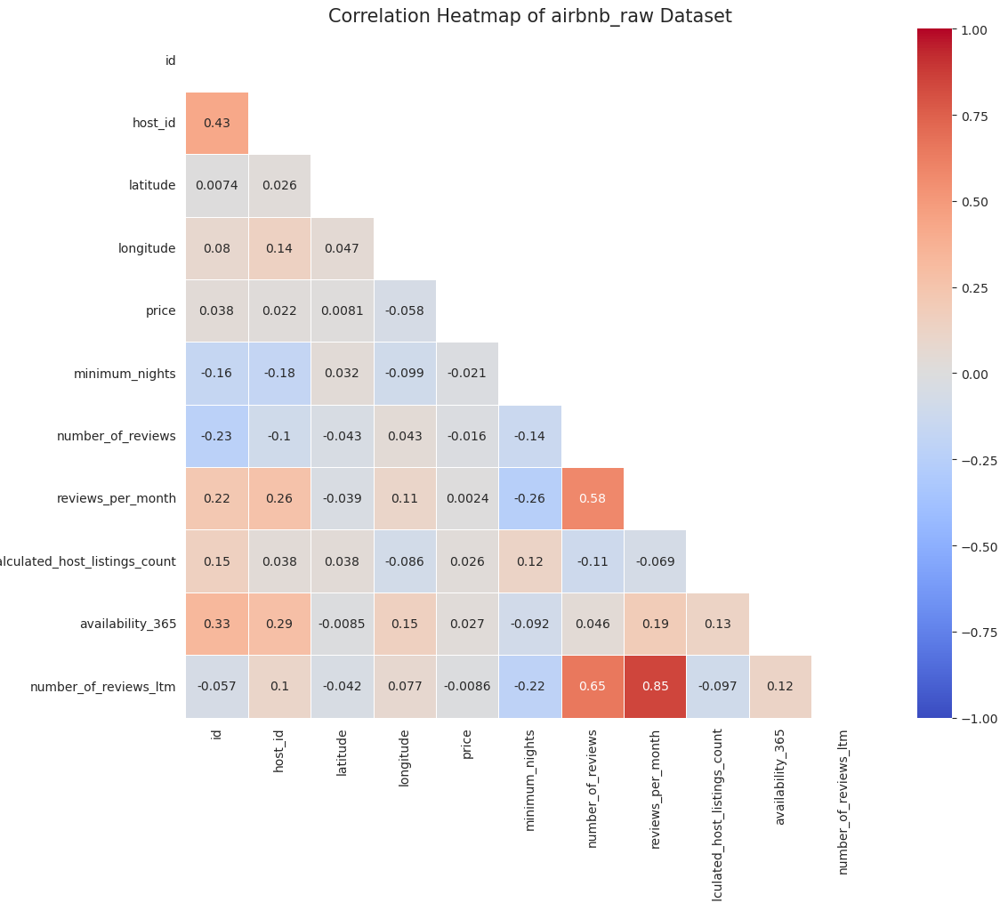

In [14]:
numerical_cols = airbnb_raw.select_dtypes(include=['number']).columns

airbnb_raw_corr = airbnb_raw[numerical_cols].corr()

mask = np.zeros_like(airbnb_raw_corr)
mask[np.triu_indices_from(mask)] = True

with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(12, 10))

    ax = sns.heatmap(
        airbnb_raw_corr, 
        mask=mask, 
        vmax=1, vmin=-1, 
        linewidths=0.5, 
        square=True, 
        cmap='coolwarm', 
        annot=True
    )

    plt.title('Correlation Heatmap of airbnb_raw Dataset', fontsize=15)
    plt.yticks(rotation=0)
    plt.tight_layout()

plt.show()

The heatmap shows that **`reviews_per_month`** is highly correlated with **`number_of_reviews`**, both of which also correlate strongly with **`number_of_reviews_ltm`**.  

Given this, we can drop **`last_review`** and **`license`**, and fill missing values in **`reviews_per_month`**.

In [16]:
drop_columns = ['last_review', 'license']

airbnb_raw = airbnb_raw.drop(drop_columns, axis=1)
airbnb_raw['reviews_per_month'].fillna(0, inplace=True)
airbnb_raw.isna().sum()

id                                 0
name                              12
host_id                            0
host_name                          5
neighbourhood_group                0
neighbourhood                      0
latitude                           0
longitude                          0
room_type                          0
price                              0
minimum_nights                     0
number_of_reviews                  0
reviews_per_month                  0
calculated_host_listings_count     0
availability_365                   0
number_of_reviews_ltm              0
dtype: int64

## **Handling Outliers**

The dataset contains significant outliers. For example, some listings have a price of **$0**, and others have **availability_365** set to **0**, which may indicate inactive or misreported listings.  

We need to identify and handle these outliers to ensure accurate analysis.

In [18]:
round(airbnb_raw.describe(), 2)

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,4.293100e+04,4.293100e+04,42931.00,42931.00,42931.00,42931.00,42931.00,42931.00,42931.00,42931.00,42931.00
mean,2.222772e+17,1.516012e+08,40.73,-73.94,200.31,18.11,25.86,0.89,24.05,140.26,7.74
std,3.344213e+17,1.621301e+08,0.06,0.06,895.08,27.46,56.62,1.64,80.87,142.00,18.29
min,2.595000e+03,1.678000e+03,40.50,-74.25,0.00,1.00,0.00,0.00,1.00,0.00,0.00
25%,1.940474e+07,1.608533e+07,40.69,-73.98,75.00,2.00,1.00,0.01,1.00,0.00,0.00
50%,4.337482e+07,7.433812e+07,40.72,-73.95,125.00,7.00,5.00,0.24,1.00,89.00,0.00
75%,6.305016e+17,2.680692e+08,40.76,-73.92,200.00,30.00,24.00,1.17,4.00,289.00,7.00
max,8.404660e+17,5.038729e+08,40.91,-73.71,99000.00,1250.00,1842.00,86.61,526.00,365.00,1093.00


For this analysis, we will focus on **short-term rentals**, filtering out listings that do not align with typical overnight stays.

### **Outlier Filtering Criteria:**
- **Minimum nights < 30**: Listings with longer stays are likely long-term rentals.
- **Availability_365 > 30**: Listings with fewer available days are rarely bookable.
- **Price < $500**: 95% of listings fall below this threshold, making higher prices outliers.

Applying these filters will help ensure more relevant and meaningful analysis.

In [20]:
print(np.percentile(airbnb_raw['price'],95))

499.0


In [21]:
airbnb = airbnb_raw[(airbnb_raw['price'] < 500) &
                    (airbnb_raw['minimum_nights'] < 30) &
                    (airbnb_raw['availability_365'] > 30)]
round(airbnb.describe(), 2)

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,1.563600e+04,1.563600e+04,15636.00,15636.00,15636.00,15636.00,15636.00,15636.00,15636.00,15636.00,15636.00
mean,3.445728e+17,2.095877e+08,40.72,-73.93,158.47,3.11,42.53,1.75,8.61,220.67,16.67
std,3.617554e+17,1.761226e+08,0.07,0.07,97.63,4.04,74.55,2.22,36.33,116.54,25.87
min,5.178000e+03,1.678000e+03,40.50,-74.25,20.00,1.00,0.00,0.00,1.00,31.00,0.00
25%,3.825154e+07,3.537336e+07,40.68,-73.97,85.00,1.00,2.00,0.40,1.00,97.00,1.00
50%,5.389251e+07,1.736853e+08,40.72,-73.94,131.00,2.00,15.00,1.24,2.00,231.00,9.00
75%,7.219198e+17,3.932667e+08,40.76,-73.90,203.00,3.00,49.00,2.53,4.00,341.00,25.00
max,8.400804e+17,5.037572e+08,40.91,-73.71,499.00,29.00,1842.00,86.61,356.00,365.00,1093.00


In [22]:
airbnb.shape

(15636, 16)

After applying these filters, the dataset has been reduced from **~40,000** to **~15,000** observations.  
This is still a substantial sample size for analysis.

## **Data Exploration and Visualization**

Now, let's examine the key characteristics of our filtered dataset through summary statistics and visualizations.

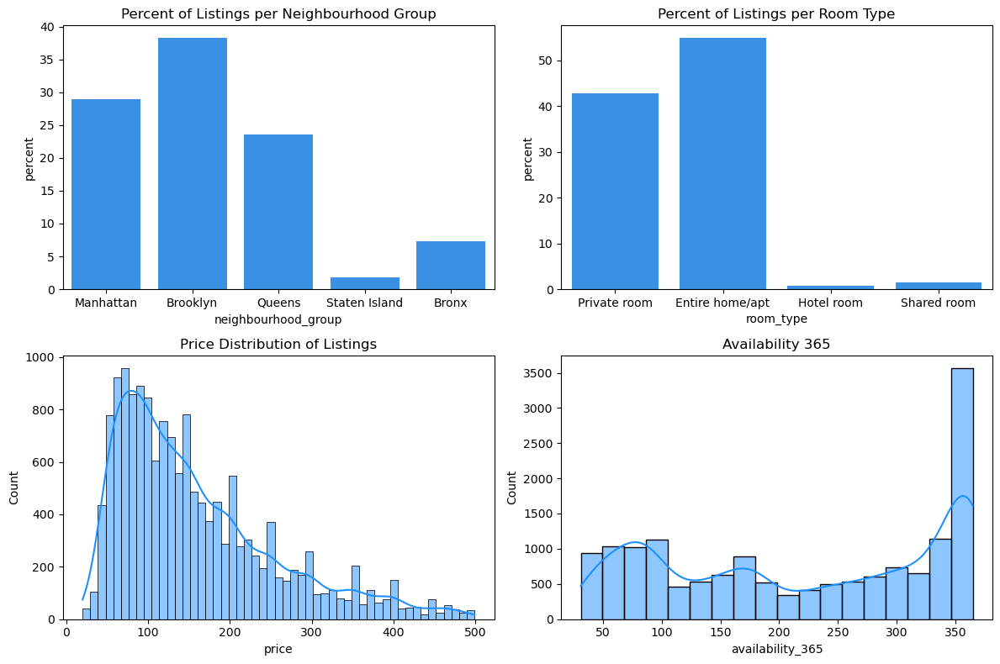

In [25]:
fig, axes = plt.subplots(2, 2, figsize=(12, 8), dpi=100)

sns.countplot(data=airbnb, x="neighbourhood_group", color="dodgerblue", stat="percent", ax=axes[0, 0])
axes[0, 0].set_title("Percent of Listings per Neighbourhood Group")

sns.countplot(data=airbnb, x="room_type", color="dodgerblue", stat="percent", ax=axes[0, 1])
axes[0, 1].set_title("Percent of Listings per Room Type")

sns.histplot(data=airbnb, x="price", kde=True, color="dodgerblue", ax=axes[1, 0])
axes[1, 0].set_title("Price Distribution of Listings")

sns.histplot(data=airbnb, x='availability_365', kde=True, color='dodgerblue', ax=axes[1, 1])
axes[1, 1].set_title('Availability 365')

plt.tight_layout()

plt.show()

From the graphs above, we observe several key patterns:

- **Location**: Most listings are in **Manhattan, Brooklyn, and Queens**, which aligns with their popularity among visitors.
- **Room Types**: The majority of listings are either **private rooms or entire homes/apartments**, as few travelers prefer shared accommodations.
- **Availability**: Many listings are available **almost year-round**, but there is a diverse distribution across different availability levels.
- **Price Distribution**: Prices peak around **$100** and gradually taper off, forming a **right-skewed distribution**, which may require transformation in later analysis.

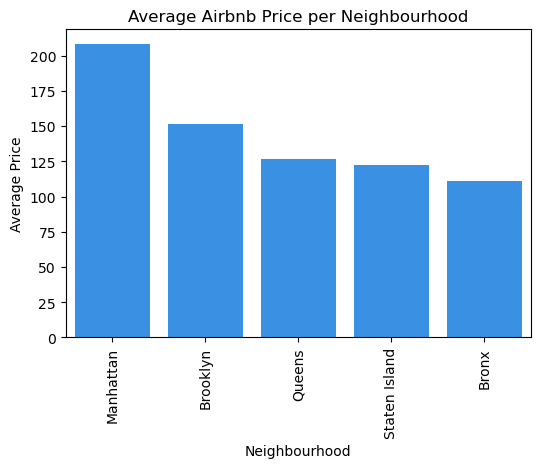

In [27]:
avg_price_per_neighbourhood = airbnb.groupby("neighbourhood_group")["price"].mean().sort_values(ascending=False)

plt.figure(figsize=(6, 4))
sns.barplot(x=avg_price_per_neighbourhood.index, y=avg_price_per_neighbourhood.values, color='dodgerblue')
plt.xticks(rotation=90)  # Rotate x-axis labels for readability
plt.xlabel("Neighbourhood")
plt.ylabel("Average Price")
plt.title("Average Airbnb Price per Neighbourhood")
plt.show()

Another useful insight is the **average price by neighborhood**.  

From the data, **Manhattan** has the highest average listing price, followed by **Brooklyn** and **Queens**.  
This aligns with expectations, as Manhattan is the most sought-after location for visitors.

In [29]:
map_center = [airbnb["latitude"].mean(), airbnb["longitude"].mean()]
airbnb_map = folium.Map(location=map_center, zoom_start=12)

marker_cluster = MarkerCluster().add_to(airbnb_map)

for _, row in airbnb.iterrows():
    folium.Marker(
        location=[row["latitude"], row["longitude"]],
        popup=f"Price: ${row['price']}<br>Room Type: {row['room_type']}",
        icon=folium.Icon(color="blue", icon="home", prefix="fa")
    ).add_to(marker_cluster)

airbnb_map

The interactive map above visualizes **Airbnb listings** based on their **longitude and latitude** data, providing a geographic overview of their distribution.

## **Price Analysis**

This section aims to address two key questions:

1. **What factors influence listing prices?**  
   - We used **clustering** to compare high-price vs low-price clusters and **regression analysis** to assess the impact of factors such as **reviews, neighborhood, room type, and other variables** on listing prices.

2. **Which listings offer the best value?**  
   - We compared **actual prices vs predicted prices** using the **residuals** to identify listings that offer **good value** compared to their predicted price based on the regression model.

## **Pricing Analysis – Part I**

To understand the factors influencing price, we will perform a regression analysis using the following variables:

- **Neighbourhood Group**  
- **Neighbourhood**  
- **Room Type**  
- **Minimum Nights**  
- **Host Listings Count** (number of listings by the host)  
- **Availability (365 days)**  
- **Number of Reviews in the Last 12 Months**  

Since **`number_of_reviews_ltm`** is highly correlated with **`reviews_per_month`** and **`number_of_reviews`**, we use **`number_of_reviews_ltm`** as it provides the most recent review activity.

### **Data Preparation for Regression**

Since the **price distribution is right-skewed**, we will apply a **log transformation** to stabilize variance and improve model performance.  

Additionally, categorical variables will be converted into **dummy variables** for regression analysis.

In [34]:
columns = [
    'id',
    "price", 
    "neighbourhood_group", 
    # "neighbourhood", 
    "room_type", 
    "minimum_nights", 
    "calculated_host_listings_count", 
    "availability_365", 
    "number_of_reviews_ltm"  # last 12 months
]
numeric_df = airbnb[columns].copy()

numeric_df["log_price"] = np.log1p(numeric_df["price"])

numeric_df = pd.get_dummies(numeric_df, columns=["neighbourhood_group", "room_type"], drop_first=True).astype(int)

y = numeric_df["log_price"]  
X = numeric_df.drop(columns=["price", "log_price", 'id'])  

X = sm.add_constant(X)

model = sm.OLS(y, X).fit()

print(model.summary())

                            OLS Regression Results                            
Dep. Variable:              log_price   R-squared:                       0.358
Model:                            OLS   Adj. R-squared:                  0.357
Method:                 Least Squares   F-statistic:                     791.2
Date:                Mon, 06 Jan 2025   Prob (F-statistic):               0.00
Time:                        11:57:04   Log-Likelihood:                -11930.
No. Observations:               15636   AIC:                         2.388e+04
Df Residuals:                   15624   BIC:                         2.398e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                                        coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const 

The regression results show that **location and room type** are the strongest predictors of price.  

- Listings in **Manhattan (+57.3%)**, **Brooklyn (+27.7%)**, and **Queens (+13.5%)** are significantly more expensive than the baseline.  
- **Entire homes/apartments** are the most expensive, while **private (-63.9%)** and **shared rooms (-104%)** are much cheaper.  
- **Longer minimum stays** slightly reduce price, while **higher availability** and **more host listings** increase it.  
- **More reviews** correlate with **lower prices**, likely due to higher booking frequency.  

Overall, the model explains **35.8% of price variation**, indicating a **moderate fit**.

## **Clustering**

In this section, we will apply **K-Means clustering** to identify patterns that differentiate high-price listings from low-price ones.  
This will help us uncover factors that may contribute to higher prices, providing insights into key characteristics of expensive listings.

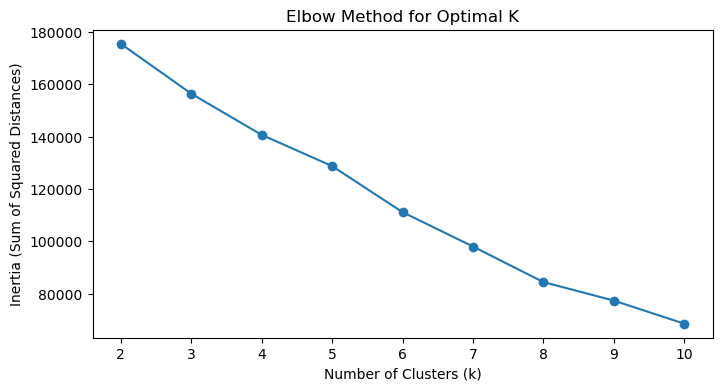

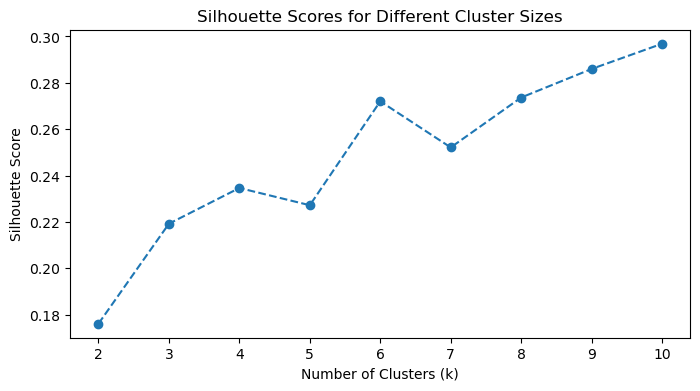

In [37]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(numeric_df.drop(columns=['id']))

inertia = []
silhouette_scores = []
cluster_range = range(2, 11)  # Testing cluster sizes from 2 to 10

for k in cluster_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(scaled_data)
    inertia.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(scaled_data, kmeans.labels_))

plt.figure(figsize=(8,4))
plt.plot(cluster_range, inertia, marker='o')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia (Sum of Squared Distances)")
plt.title("Elbow Method for Optimal K")
plt.show()

plt.figure(figsize=(8,4))
plt.plot(cluster_range, silhouette_scores, marker='o', linestyle="dashed")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Scores for Different Cluster Sizes")
plt.show()

From the plots above, it seems like 6 is a good number for k. 

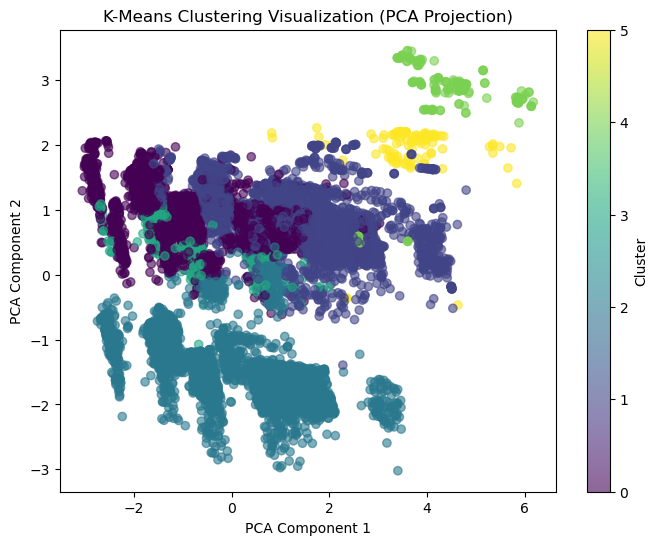

In [39]:
optimal_k = 6  
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
numeric_df["Cluster"] = kmeans.fit_predict(scaled_data)

pca = PCA(n_components=2)
reduced_data = pca.fit_transform(scaled_data)

plt.figure(figsize=(8,6))
plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=numeric_df["Cluster"], cmap="viridis", alpha=0.6)
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.title("K-Means Clustering Visualization (PCA Projection)")
plt.colorbar(label="Cluster")
plt.show()

Below are the characteristics of each cluster:

In [41]:
numeric_df.groupby("Cluster").mean().sort_values(by="price", ascending=False).drop(columns=['id'])

,price,minimum_nights,calculated_host_listings_count,availability_365,number_of_reviews_ltm,log_price,neighbourhood_group_Brooklyn,neighbourhood_group_Manhattan,neighbourhood_group_Queens,neighbourhood_group_Staten Island,room_type_Hotel room,room_type_Private room,room_type_Shared room
Cluster,,,,,,,,,,,,,
4,342.315436,1.187919,356.000000,247.791946,0.073826,5.194631,0.060403,0.939597,0.000000,0.0,0.0,0.281879,0.000000
5,269.376068,1.008547,13.794872,248.119658,11.923077,5.059829,0.034188,0.914530,0.051282,0.0,1.0,0.000000,0.000000
1,203.842358,3.484350,9.771076,202.711446,17.065570,4.664154,0.000000,0.978067,0.000685,0.0,0.0,0.440484,0.016221
2,150.480561,3.357712,3.271511,208.900733,17.067559,4.392288,0.950924,0.000000,0.000000,0.0,0.0,0.384321,0.009082
3,122.323944,2.588028,2.316901,234.552817,15.397887,4.183099,0.000000,0.000000,0.000000,1.0,0.0,0.348592,0.010563
0,118.197158,2.530115,3.625987,252.536431,16.472818,4.136025,0.000000,0.000000,0.831040,0.0,0.0,0.501466,0.023912


In [42]:
high_price_clusters = numeric_df[numeric_df["Cluster"].isin([4, 5])]  # Adjust based on findings
low_price_clusters = numeric_df[numeric_df["Cluster"].isin([0, 3])]  # Adjust based on findings

comparison = pd.concat([
    high_price_clusters.mean().rename("High Price Clusters"),
    low_price_clusters.mean().rename("Low Price Clusters")
], axis=1)

round(comparison.iloc[1:],2)

,High Price Clusters,Low Price Clusters
price,310.23,118.45
minimum_nights,1.11,2.53
calculated_host_listings_count,205.48,3.55
availability_365,247.94,251.45
number_of_reviews_ltm,5.29,16.41
log_price,5.14,4.14
neighbourhood_group_Brooklyn,0.05,0.00
neighbourhood_group_Manhattan,0.93,0.00
neighbourhood_group_Queens,0.02,0.78
neighbourhood_group_Staten Island,0.00,0.06


The table suggests the following insights from the clustering:

- **Low-price clusters** tend to have **higher minimum nights** and **more reviews in the last 12 months**.
- **High-price clusters** are more likely to be located in **Manhattan**, while **low-price clusters** are more common in **Queens**.
- **Hotel rooms** are more prevalent in **high-price clusters**, whereas **private rooms** are more associated with **low-price clusters**.

## **Price Analysis – Part II**

In this section, we will focus on identifying **listings that offer the best value**.  
We will apply various methods to find affordable listings with high ratings or features that stand out compared to similar listings.

In [45]:
numeric_df["predicted_log_price"] = model.predict(X)

numeric_df["price_residual"] = numeric_df["log_price"] - numeric_df["predicted_log_price"]

top_10_value_listings = airbnb[airbnb['id'].isin(numeric_df.nsmallest(10, "price_residual")["id"])]

top_10_overpriced_listings = airbnb[airbnb['id'].isin(numeric_df.nlargest(10, "price_residual")["id"])]

In [46]:
top_10_overpriced_listings[columns]

,id,price,neighbourhood_group,room_type,minimum_nights,calculated_host_listings_count,availability_365,number_of_reviews_ltm
16369,32501807,449,Manhattan,Shared room,1,6,88,15
16723,33396290,429,Manhattan,Shared room,1,6,90,10
19659,40192946,476,Manhattan,Private room,3,1,279,47
24102,48490427,420,Brooklyn,Private room,1,3,180,1
26714,51866988,189,Manhattan,Private room,1,9,325,889
28896,53843545,213,Manhattan,Private room,1,7,365,1093
36638,734760353530493041,480,Queens,Shared room,1,6,365,0
38453,769636927103230399,419,Queens,Shared room,1,3,355,0
38639,769580756557673403,499,Queens,Private room,1,13,362,2
40135,798091922720670115,499,Brooklyn,Private room,1,1,365,3


In [47]:
top_10_value_listings[columns]

,id,price,neighbourhood_group,room_type,minimum_nights,calculated_host_listings_count,availability_365,number_of_reviews_ltm
23910,48270362,50,Queens,Entire home/apt,3,1,262,36
28375,53512507,40,Brooklyn,Entire home/apt,5,1,111,25
30575,579960719337758051,51,Queens,Entire home/apt,2,1,135,1
31956,624399238774557651,49,Manhattan,Entire home/apt,5,1,242,6
37567,754096019257201208,52,Brooklyn,Entire home/apt,2,4,82,4
38036,762291016757478352,46,Manhattan,Private room,1,53,242,1
38785,774502052871999131,50,Bronx,Entire home/apt,1,1,339,1
39836,791959004693148454,52,Manhattan,Private room,1,53,247,0
41164,812963464211376938,44,Bronx,Entire home/apt,1,8,303,4
41521,819414242602084580,50,Staten Island,Entire home/apt,2,1,298,1


## **Conclusion**

This analysis highlighted key factors influencing Airbnb pricing in New York City. **Location** and **room type** were found to be the strongest price predictors, with listings in **Manhattan** and **entire homes/apartments** commanding the highest prices. We also identified that **higher availability** and **more host listings** are associated with higher prices, while **longer minimum stays** and **more reviews** tend to lower prices. Additionally, clustering revealed that **high-price listings** are more likely to be in Manhattan and feature hotel rooms, whereas **low-price listings** are often found in Queens and feature private rooms. Finally, we explored methods for identifying the best value listings, focusing on affordability combined with high ratings and good features.